# Festive introduction to Genetic Algorithms - Santa's Route Optimization

This is a companion notebook for the blog post [Festive introduction to Genetic Algorithms - Santa's Route Optimization](https://medium.com/@edgars.garsneks/ga-tsp-fbf5c28d92e1
).



Starting with set of cities to plan route for Santa's journey. We will use Genetic Algorithm to find the shortest route to visit all cities.

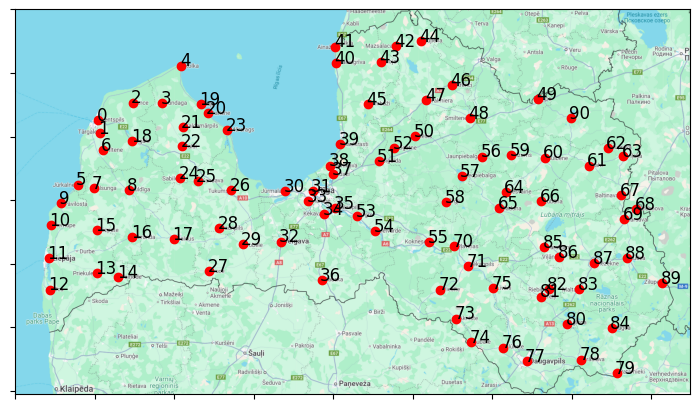

In [63]:
import numpy as np
import random
import math
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

map_image = plt.imread('images/larger_map.png')

city_locations = np.array([[261, 348], [266, 388], [370, 293], [462, 295], [523, 177], [197, 551], [275, 442], [247, 561], [357, 568], [144, 610], [112, 679], [106, 783], [109,881],  [257,829],  [325,842],  [257,695], [369,717], [499, 722],[369, 414],  [583,297], [606, 326], [527, 369],[525, 431], [667, 380], [520, 531], [574, 539],[679, 569], [610, 822], [642, 688], [716, 739], [849, 570], [935, 571], [835, 730], [921, 604],[972, 644], [1007, 625], [964, 850], [999, 517],  [991, 491],[1022, 423], [1008, 168], [1007, 117], [1197, 115],  [1151, 166], [1277, 99], [1109, 297], [1372, 238], [1293, 285], [1431, 341], [1644, 282], [1257, 399], [1143, 476],  [1192, 436],  [1075, 649], [1132, 698], [1302, 731], [1469, 463], [1404, 525], [1355, 605], [1559, 458], [1665, 466], [1803, 491], [1863, 435], [1911, 461], [1542, 574], [1521, 625], [1653, 602], [1905, 584], [1953, 629], [1915, 660], [1379, 745], [1424, 808],[1337, 881], [1387, 972],[1434, 1046],[1503, 876],[1534, 1063],[1608, 1106],[1778, 1101],[1891, 1142],[1735, 989],[1653, 903],[1677, 880],[1773, 880],[1875, 1002],[1663, 748],[1711, 780],[1821, 797],[1922, 781],[2034, 861],[1746, 341]])

# For quick test of 20 cities
subset = [0, 3, 8, 26, 30, 17, 11, 32, 31, 36, 51, 50, 47, 90, 61, 87, 71, 77, 65, 60]
#city_locations = np.array(city_locations[subset])
ration = 0.22 # KM per pixel

city_count = len(city_locations)

fig, ax = plt.subplots(figsize=(10, 5))

def plotMap(ax):
    ax.imshow(map_image)
    ax.scatter(city_locations[:, 0], city_locations[:, 1], c='r', marker='o')
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    for i in range(city_count):
        ax.text(city_locations[i, 0]- 5, city_locations[i, 1] - 0, i, fontsize=12)

plotMap(ax)

Initial candidate solution is a random permutation of cities, initial population will consist of many such random permutations.

In [39]:
def initial_solution():
    genes = list(range(city_count))

    for i in range(city_count):
        j = random.randint(0, city_count - 1)
        genes[i], genes[j] = genes[j], genes[i]
    
    return genes

print("Example of initial solution:", initial_solution())

Example of initial solution: [66, 24, 89, 5, 25, 65, 28, 56, 36, 34, 19, 80, 8, 10, 22, 2, 35, 23, 12, 63, 81, 90, 47, 73, 48, 44, 11, 61, 1, 57, 38, 83, 43, 52, 49, 58, 4, 75, 33, 54, 13, 67, 51, 53, 85, 62, 50, 31, 3, 20, 30, 84, 42, 29, 68, 71, 74, 45, 21, 88, 46, 16, 76, 72, 15, 55, 40, 60, 87, 7, 6, 77, 37, 39, 79, 41, 0, 59, 64, 18, 86, 82, 14, 9, 17, 69, 70, 26, 32, 27, 78]


As all the cities are static, we can precompute the distances between all pairs of cities and store them in a matrix.

In [55]:
def distance(a, b):
    return math.sqrt((a[0] - b[0])**2 + (a[1] - b[1])**2)

def get_distance_matrix(cities):
    n = len(cities)
    distances = [[0] * n for _ in range(n)]

    for i in range(n):
        for j in range(n):
            distances[i][j] = distance(cities[i], cities[j])

    return distances

distance_matrix = get_distance_matrix(city_locations)

Then we can define the fitness function as inverse the total distance of the route.

In [17]:

def get_total_distance(chromosome):
    total_distance = 0
    # Calculate the total distance of the route
    for i in range(len(chromosome) - 1):
        city_a = chromosome[i]
        city_b = chromosome[i + 1]
        total_distance += distance_matrix[city_a][city_b]

    # Add the distance from the last city back to the first city
    first_city = chromosome[0]
    last_city = chromosome[-1]

    return total_distance + distance_matrix[first_city][last_city]
    
def fitness_function(chromosome):
    # Return the inverse so that we can maximize the fitness
    return 1.0 / get_total_distance(chromosome)

Selection methods to play around with.

In [18]:
def tournament_selection(population, fitness_values):
    k = 5
    best = len(population)
    for _ in range(k):
        i = random.randint(0, len(population) - 1)
        if i < best:
            best = i
    return population[best]

def roulette_wheel_selection(population, fitness_values):
    total = sum(fitness_values)
    p = random.uniform(0, total)
    cumulative = 0

    for i in range(len(population)):
        cumulative += fitness_values[i]
        if cumulative > p:
            return population[i]
        
    return population[-1] 

Crossover methods to play around with.

In [19]:
def order_crossover(parent1, parent2):
  ### Order Crossover (OX1) ###
  child = [] 
  for i in range(0, len(parent1)):
    child.append(-1)

  # Select a random slice of the first parent and copy it to the child
  start = random.randint(0, len(parent1) - 1)
  end = random.randint(start, len(parent1) - 1)

  child[start:end] = parent1[start:end]
  
  # Copy the remaining genes from the second parent to the child in order they appear in the second parent
  for gene in parent2:
    if gene not in child:
      for i in range(0, len(child)):
        if child[i] == -1:
          child[i] = gene
          break

  return child  

def position_crossover(parent1, parent2):
  child = list(parent1)

  for i in range(len(parent1)):
    if random.random() < 0.5:
      child[i] = None

  for gene in parent2:
    if gene not in child:
      for i in range(len(child)):
        if child[i] is None:
          child[i] = gene
          break
        
  return child


Mutations to play around with.

In [56]:
def swap_mutation(chromosome):
    gene_count = len(chromosome)

    i = random.randint(0, gene_count - 1)
    j = random.randint(0, gene_count - 1)

    chromosome[i], chromosome[j] = chromosome[j], chromosome[i]
    return chromosome

def insert_mutation(chromosome):
    gene_count = len(chromosome)
    i = random.randint(0, gene_count - 1)
    j = random.randint(0, gene_count - 1)

    ele = chromosome.pop(j)
    chromosome.insert(i, ele)
    return chromosome

def mutation(chromosome):
    if random.random() < 0.5:
        swap_mutation(chromosome)

    if random.random() < 0.5:
        insert_mutation(chromosome)

    return chromosome

GA setup

In [57]:
class GeneticAlgorithm:

    def __init__(self, initial_solution, fitness_function, selection, crossover, mutation):
        self.initial_solution = initial_solution
        self.fitness_function = fitness_function
        self.selection = selection
        self.crossover = crossover
        self.mutation = mutation

    def create_offspring(self, population, fitness_values):
        # Select parents
        parent_a = self.selection(population, fitness_values)
        parent_b = self.selection(population, fitness_values)
        # Crossover
        child = self.crossover(parent_a, parent_b)
        # Mutation
        child = self.mutation(child)
        
        return child
    
    def create_new_generation(self, population, fitness_values, elitism = 0.1):
         # Select elite to pass to the next generation
        population_size = len(population)
        number_of_elites = int(elitism * population_size)
        num_offspring = population_size - number_of_elites

        # Start next generation with elites
        new_population = population[:number_of_elites]

        for _ in range(num_offspring):
            new_population.append(self.create_offspring(population, fitness_values))

        return new_population


    def epoch(self, population=[], generations=1000, sample_rate=50, sample_amount=1, elitism=0.1, population_size=100, verbose=False):
        """
        Runs the genetic algorithm for a given number of generations.

        Parameters:
        generations (int): Number of generations to run the algorithm for
        population_size (int): Number of individuals in the population
        population (list): Initial population of solutions, if not provided, will be generated randomly, used to continue the algorithm from a previous run
        sample_rate (int): How often to sample the population results. Expressed in iterations.
        sample_amount (int): How many of the best individuals to sample and return
        elitism (float): Percentage of the population to keep as elite

        Returns:
        list: List of tuples containing the generation number, best individuals (sample_amount), their fitness, best fitness and mean fitness
        """
        # List to store sampled results returned by the function
        samples = []
        # If population is not provided, generate a new one using initial_solution
        while len(population) < population_size:
            population.append(self.initial_solution())
    
        for it in range(generations):
            # Evaluate fitness of each individual
            fitness = [self.fitness_function(ind) for ind in population]
            # Sort population by fitness, in descending order
            weighted_population = [x for x in sorted(zip(fitness, population), reverse=True, key=lambda pair: pair[0])]
            fitness, population = [list(t) for t in zip(*weighted_population)]

            # Sample the population and store the results
            if it % sample_rate == 0:
                if verbose:
                    print(f"[{it}] Best: {fitness[0]:.10f} Average: {np.mean(fitness):.10f} Genotype{{genes={population[0:sample_amount]}}}")
                samples.append((it, population[0:sample_amount], fitness[0:sample_amount] , fitness[0], np.mean(fitness)))
            # Create new generation
            new_population = self.create_new_generation(population, fitness, elitism)
            population = new_population
        return samples

Now we can define the Genetic Algorithm setup. We will use the following parameters:
* Population size: 1000 - Number of candidate solutions in each generation, impacts performance, it was not possible to introduce concurrency in this implementation.
* Number of generations: 2500 - Afterwards convergence slows down
* Selection method: Tournament selection 
* Crossover method: Position crossover
* Mutation method: Insertion mutation

In [61]:
ga = GeneticAlgorithm(initial_solution, fitness_function, tournament_selection, position_crossover, insert_mutation)
results = ga.epoch(generations=2500, population_size=1000, sample_rate=50, sample_amount=1, elitism=0.1, verbose=True)

[0] Best: 0.0000169578 Average: 0.0000143948 Genotype{genes=[[65, 12, 36, 86, 48, 87, 22, 14, 73, 63, 7, 2, 40, 23, 24, 26, 11, 37, 6, 82, 78, 61, 75, 28, 5, 47, 71, 54, 32, 20, 31, 55, 35, 30, 45, 39, 60, 4, 83, 89, 64, 62, 90, 33, 56, 88, 38, 50, 44, 84, 74, 58, 1, 41, 72, 21, 17, 15, 3, 9, 59, 52, 16, 19, 10, 79, 18, 8, 29, 13, 85, 66, 42, 43, 27, 25, 81, 80, 76, 69, 53, 67, 77, 0, 51, 57, 46, 68, 49, 34, 70]]}


[50] Best: 0.0000344872 Average: 0.0000283791 Genotype{genes=[[27, 13, 12, 16, 14, 7, 11, 8, 15, 1, 21, 19, 10, 9, 3, 2, 6, 20, 18, 5, 22, 0, 4, 23, 17, 25, 24, 26, 29, 47, 37, 31, 33, 40, 28, 30, 43, 72, 41, 53, 45, 51, 35, 44, 48, 42, 52, 39, 75, 50, 54, 70, 58, 36, 57, 73, 71, 65, 90, 49, 56, 62, 60, 74, 67, 68, 69, 88, 79, 82, 61, 66, 64, 63, 87, 77, 83, 76, 85, 80, 84, 89, 78, 59, 46, 86, 81, 55, 38, 32, 34]]}
[100] Best: 0.0000505727 Average: 0.0000421782 Genotype{genes=[[16, 12, 15, 14, 13, 10, 8, 11, 7, 5, 6, 9, 0, 1, 18, 21, 4, 23, 2, 19, 3, 24, 20, 28, 25, 26, 17, 22, 27, 29, 30, 36, 32, 33, 31, 35, 38, 53, 37, 51, 39, 45, 44, 42, 41, 40, 43, 47, 52, 48, 57, 56, 58, 50, 49, 64, 61, 46, 60, 90, 65, 66, 63, 62, 59, 85, 68, 67, 69, 88, 78, 89, 84, 75, 80, 83, 82, 81, 86, 77, 79, 87, 76, 73, 74, 55, 71, 72, 54, 70, 34]]}
[150] Best: 0.0000659634 Average: 0.0000534888 Genotype{genes=[[13, 14, 11, 12, 15, 7, 5, 9, 10, 8, 6, 0, 1, 18, 2, 3, 20, 23, 16, 4, 19, 21, 22, 17, 24, 25, 26,

Now to plot the outcome 

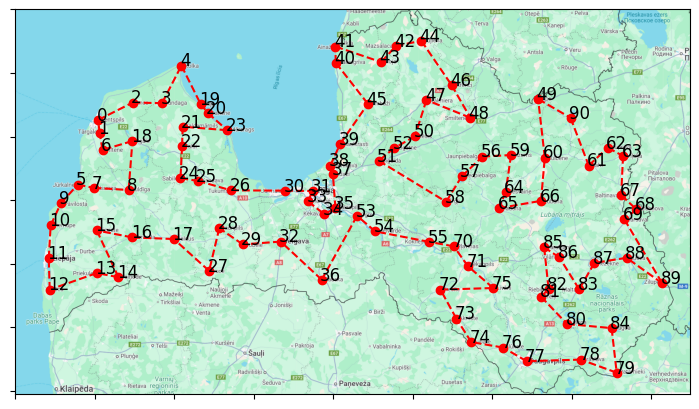

In [62]:
def plot_solution(ax, chromosome, style='r--'):
    plotMap(ax)
    return plot_path(ax,chromosome, style)

def plot_path(ax, chromosome, style='r--'):
    for i in range(len(chromosome) - 1): 
        city_a = chromosome[i]
        city_b = chromosome[i + 1]
        ax.plot([city_locations[city_a][0], city_locations[city_b][0]], [city_locations[city_a][1], city_locations[city_b][1]], style)

    first_city = chromosome[0]
    last_city = chromosome[-1]
    
    return ax.plot([city_locations[first_city][0], city_locations[last_city][0]], [city_locations[first_city][1], city_locations[last_city][1]], style)

fig, ax = plt.subplots(figsize=(10, 5))

plot_solution(ax, results[-1][1][0])


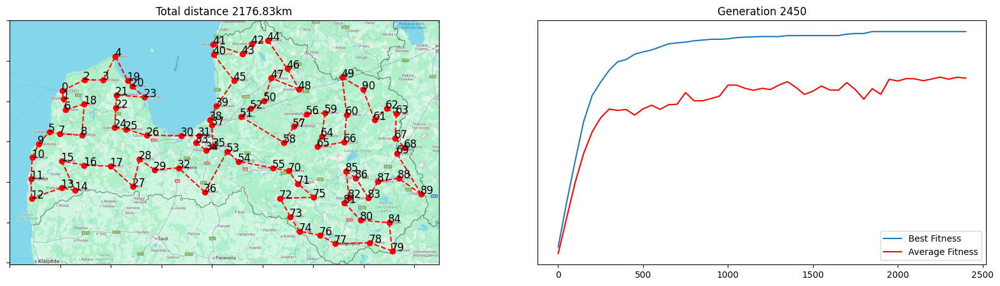

In [ ]:
iterations = [x[0] for x in results]
best = [x[3] for x in results]
average = [x[4] for x in results]
routes = [x[1][0] for x in results]


def showAnimation(iterations, best, average, routes):

    fig, ax = plt.subplots(1,2, figsize=(20, 5))
    matplotlib.rcParams['animation.embed_limit'] = 2**128
    
    def animate(i):
        ax[0].clear()
        ax[0].set_title(f"Total distance {get_total_distance(routes[i])*0.22:.2f}km")

        ax[1].clear()
        ax[1].plot(iterations[:i], best[:i], label='Best Fitness')
        ax[1].plot(iterations[:i], average[:i], label='Average Fitness', color='red')
        ax[1].set_title(f"Generation {iterations[i]:04d}")
        ax[1].legend()
        ax[1].set_yticks([])


        return plot_solution(ax[0], routes[i])

    ani = FuncAnimation(fig, animate, frames=len(routes), interval=100, blit=True)  
    return HTML(ani.to_jshtml(fps=10))

showAnimation(iterations, best, average, routes)

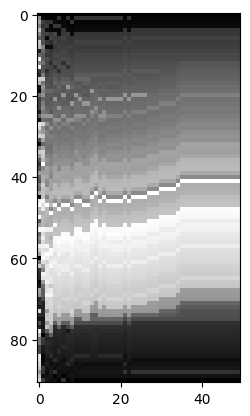

In [73]:
def plotHeatMap(ax, data):
    rows = len(data)
    cols = len(data[0])
    image = [[0] * rows for _ in range(cols)]

    for r in range(rows):
        for c in range(cols):
            image[c][r] = data[r][c]
    #ax.set_yticklabels(range(rows))
    ax.imshow(image, cmap='gray'
              ,interpolation='nearest')


fig, ax = plt.subplots()

canditates = [i[1][0] for i in results]

for i in range(len(canditates)):
    while canditates[i][0] != 0:
        canditates[i].append(canditates[i].pop(0))

plotHeatMap(ax, canditates)

For understanding distribution of distances based on configuration let's look atleast on 100 runs of the algorithm.

Text(0.5, 1.0, 'Crossover & Mutation Comparison')

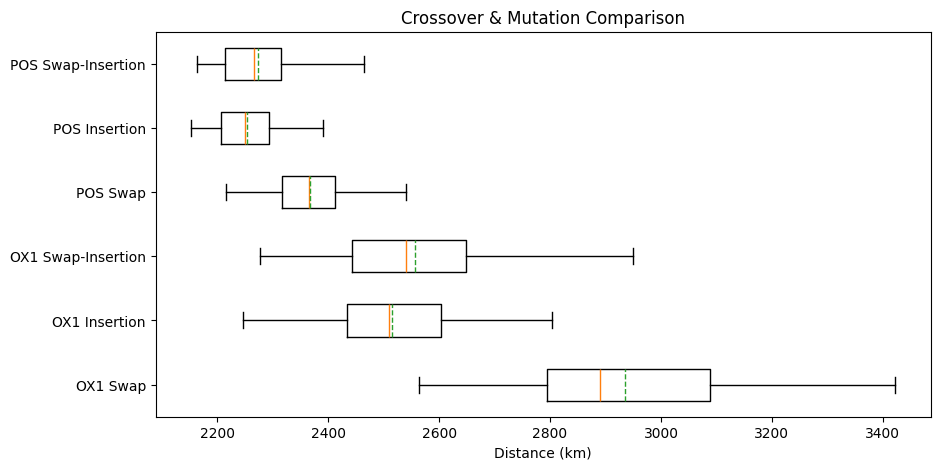

In [74]:
ox1_swap = [13088.31957019411, 12729.724653223619, 12753.558667051213, 11884.48157568962, 12066.010168016513, 15115.797501569841, 14562.762200011324, 14121.994450507174, 12081.310310750256, 12403.66272749765, 14112.081934853706, 13174.353158547443, 14490.39350230681, 12418.192508555125, 13136.932054775587, 13037.124566109562, 12467.231813459843, 14789.366818345841, 13118.119439002392, 14120.10666899819, 13188.966623141327, 14016.273799671215, 12704.468601519586, 14141.852830752816, 13575.553626559207, 12454.175812129306, 12996.322754397293, 13882.499626775536, 11679.915848682243, 14605.322385443087, 14295.128382686486, 14940.441517184916, 13012.93968190261, 13089.101190179652, 13508.056441039931, 13744.6129473026, 12532.840051978079, 13437.593331479753, 13268.530660372382, 13069.812055144774, 12497.350662335615, 12587.563576332845, 12813.791857897217, 12488.875920686462, 13413.874040954555, 13997.229652784014, 15422.239014098874, 13138.633506785916, 12322.324349329203, 12305.716746955699, 13192.868324353884, 14779.62090350785, 15558.139497387463, 14989.915766501077, 12675.881246429188, 13356.728626499316, 13030.906278263783, 12970.109858291315, 12085.240650722093, 14755.147904725885, 13023.465997303638, 14404.52360585662, 12350.595197057706, 12889.490202244511, 13228.572278396497, 12911.861577992702, 13735.203142221653, 14902.861518550904, 13012.641808112468, 12065.784762230645, 13771.450750826172, 13571.60768158674, 14801.685407969404, 14215.96358850273, 13068.95118746801, 14206.707172533204, 11848.628227603267, 12078.302915619566, 14875.714134284242, 12761.017798196608, 14116.711229321485, 13779.605713190107, 13128.013448744923, 12762.821872420847, 13054.804153556423, 12680.488566364926, 12817.451890209279, 12884.037969519863, 11651.202793601722, 13845.25556224154, 14111.26224266905, 13341.500057941304, 13425.007710296773, 13580.850587242889, 12616.861120766967, 14817.324132263491, 13378.273980866588, 13455.188793503365, 12117.24167058666, 12454.161756579153]
ox1_insertion = [12366.131266907312, 10527.894913015058, 11112.827964023802, 12464.553283677647, 11167.659917305185, 11109.6432550662, 11523.549863208018, 11834.518952866558, 11103.371891482748, 11625.857231824937, 11094.414587153366, 11098.634751960548, 12288.963634525948, 11347.437726649689, 10899.095371870295, 10893.793011021547, 10633.339045927505, 10650.983462529312, 12708.53457965013, 11951.381675884742, 10991.633929309435, 11554.212446810337, 12382.85230871461, 11166.38386066867, 10837.916023874752, 11202.861742889132, 10423.029320189653, 12614.630661337113, 11577.220777316263, 12054.36034843736, 11037.251370322443, 11120.391244436694, 11228.548409519524, 11854.871125538548, 11195.929559590517, 10660.147208601524, 11574.313945831505, 11125.14683250684, 11935.195403008693, 12126.296196868252, 11363.268703197013, 11387.152608098124, 11846.603089388866, 11192.173463861158, 12266.172709998193, 11608.974162653816, 10852.87237560729, 11597.146244596255, 11590.75088593979, 11472.429295478867, 11663.129350352421, 11764.903142984309, 12739.369585017344, 11587.013260571499, 12108.85772217406, 11179.174858535645, 10899.884683089242, 10568.839197108362, 10211.428765848475, 10622.486572132397, 11978.698774362443, 12122.661479782266, 11361.617302394317, 11788.203315033612, 12009.125897213291, 10819.678711991519, 11154.060749199045, 11857.757066850982, 11450.565490994453, 11727.786841937641, 10862.167505306774, 11504.609784964787, 12282.093781988975, 11870.588199523248, 11278.99104828949, 11477.310484584936, 11033.447723856474, 12539.06720138548, 11537.087820753468, 11149.471474379905, 10795.064866571462, 11329.594872742866, 11034.794435984735, 10923.705698245909, 10921.50523594171, 11941.362859207979, 12289.04417429623, 11586.043781789771, 12131.440643731952, 11439.638862033591, 11176.570612389316, 11561.930229997202, 10832.47315341883, 10567.602551221053, 11447.613507364265, 10749.770996108848, 11067.806766779913, 11492.058423545961, 11071.23899642402, 11432.018109017401]
ox1_swap_insertion = [15362.772452015164, 16325.983860430728, 15831.716870209348, 14817.750969429335, 16720.209334100433, 15348.639129742965, 16699.66401023094, 15063.27223025739, 14626.410048704945, 16832.875190877996, 14991.865673296832, 14617.803762039968, 13809.47639266095, 15931.621690243317, 16312.335314571672, 15852.702418327957, 15107.821421150664, 15644.269200712726, 14198.288008184883, 16978.31044430203, 14389.063600436184, 13826.320927393906, 14556.212648672252, 13879.80233608517, 14089.150702594476, 15175.222015627767, 12719.93733508585, 14452.424698407636, 14625.960808117692, 15382.012794437027, 15462.680392941107, 14986.919479942719, 14268.722830673882, 14462.939645863393, 14307.175527261184, 14375.697439597265, 16389.118545678542, 14761.109886494949, 16241.804257932105, 14657.618578698031, 13634.531440794626, 16089.182534745885, 12909.012591094317, 13725.383962155169, 14218.93288235154, 15199.35155438501, 14808.923959776386, 14878.117813624878, 15245.729852349696, 13799.934071390222, 15321.352768065384, 14212.147915731859, 15205.96448579795, 14460.571643206646, 13530.075442962145, 14108.72455287815, 13900.347535502291, 15465.293317515465, 13923.22267052121, 15841.441356437392, 15781.421006953231, 15471.550225853904, 15774.927957152599, 14864.614968132879, 14558.142119194874, 14361.488269391908, 16805.142165118235, 15953.612270114363, 15802.853287643864, 16243.95142573972, 16796.959509839395, 14591.704343656951, 16560.49103367656, 15582.047608814779, 17615.246202122435, 14404.277343457834, 13536.504896453727, 15924.022467245384, 13814.907153916807, 14378.550054092444, 15580.921421223165, 15516.927516106633, 15419.936356061415, 14816.756481238483, 16579.63079815459, 14522.361034587051, 14181.619780979096, 14241.436818723718, 13409.79360158942, 15107.687349289732, 13157.770786684207, 15267.874954540224, 14873.23359881731, 13274.981335882585, 13317.92177848536, 15609.63794083681, 15282.622241811552, 14631.847591914186, 14722.709826134094, 13583.807737638857]
pos_insertion = [10575.411552038788, 9902.240767069894, 10029.142288769288, 10071.333377219951, 10029.142288769288, 10507.106929360867, 10309.019666150212, 10298.603765579097, 10587.178522021868, 9797.503066544034, 10099.82844563646, 10378.704918466181, 10143.227135638424, 11262.884562229521, 10448.962586669379, 9940.712418634075, 9844.60450097511, 10389.16116472596, 10652.082712050702, 10103.274059013998, 9921.723019782341, 10236.24172475255, 10864.007396385143, 10224.640801291556, 10289.536655634669, 10632.731598550576, 9971.53474879579, 10478.106162309461, 10147.569224596451, 10473.047701628775, 9894.407019028895, 10161.401768033771, 10642.459547088181, 9879.967474612027, 10115.038487594129, 11059.852665143628, 9972.319217464259, 10183.506949281753, 10082.166362405149, 10543.436211958688, 10305.10887536609, 10164.523723202228, 10431.8086038218, 10426.681263099621, 10325.17786786005, 10022.955279143383, 10330.56536133941, 10232.530438043601, 10315.249111372654, 9918.253961586466, 10591.00323728272, 10080.672718058517, 10461.751326176285, 10114.207809694315, 10107.497214989862, 10220.965237446793, 10129.742684572706, 10165.829651074233, 10168.345565921349, 9949.342201500973, 10236.127174047684, 10271.086532184547, 10596.98375929764, 10614.276054308088, 10318.668999510583, 10596.345691767181, 10281.874787963128, 9949.342201500975, 9995.086217862134, 9844.60450097511, 10258.723737354714, 10138.065902323082, 9927.068909043104, 10377.148058724393, 10207.243849597, 10245.976579072896, 9831.651023068178, 10328.49506389912, 10231.308342300978, 10302.91320348021, 10632.50815410881, 9981.547093408657, 10518.858299361442, 10421.946847957337, 10420.78159704689, 9784.5495886371, 10557.005182424222, 10108.61994827476, 9971.53474879579, 9836.99691232894, 10071.01741409631, 9979.926806110427, 10786.368645199376, 9965.25981520545, 10282.808562703558, 10096.1864796929, 10693.067423267512, 10482.777487929916, 10081.126311069764, 9871.534261014847]
pos_swap = [11014.380898769956, 11063.673617728951, 10922.001687100359, 10585.290808101498, 11381.111845273437, 10185.188047887626, 10870.919652687324, 10903.193542384157, 10696.419644861126, 10962.729388162159, 11431.630379063728, 11148.029750656893, 10739.167165562252, 10721.58889820963, 10115.581890519737, 11205.899148457996, 10380.475702202893, 10828.446943489522, 10631.200989426474, 10633.913804342797, 11064.824931561147, 10748.327539862035, 10634.596038129548, 10820.340674564912, 10195.72423388633, 11088.73560439805, 10621.252383902101, 10452.4057016526, 10998.211930506788, 10645.282654637209, 11112.72204419349, 10609.438180792935, 10477.657097445875, 10344.572421241193, 10773.96358693861, 10377.876386120466, 10225.28632644228, 10657.03650162821, 10868.84068028029, 10347.964592180433, 10500.972453833354, 11112.478532127427, 11458.887801028166, 10652.551501033699, 10371.087058389661, 10890.518929041093, 10986.35467449026, 10893.17915398341, 11296.56784668434, 10762.53970646306, 11541.615671615418, 10673.146328032251, 11028.192083746313, 10897.777260172552, 11454.29908409548, 11411.566677332685, 10535.325097237548, 10353.796581816303, 10379.619990985948, 10819.258279955508, 11111.240337804094, 11378.13502053621, 10598.043190498855, 11079.643048243232, 10886.951085627657, 10191.607765295275, 10594.257905786564, 10530.677575191221, 10513.89934489764, 10794.907395614282, 11386.951847197619, 10339.742503991269, 10853.650534624667, 10760.402378036215, 10846.389936384285, 10927.66954884944, 10341.069655653246, 10587.779534609934, 10633.108860907487, 10719.12782817535, 11020.613087402477, 10815.309544881782, 10680.767215916827, 10702.683293364984, 10633.552712680106, 10261.55815250518, 10487.36617833705, 10898.685436071168, 10901.34261679613, 10204.56992401394, 11165.216766013367, 10808.327721574111, 10068.027712841216, 10714.17669085319, 10356.947736212776, 10900.9136813575, 10190.244321867889, 11548.409929473593, 10759.8722966701, 10697.346458026286]
pos_swap_insert = [14393.799414858446, 11984.145255071584, 13234.267848392905, 11753.58938731069, 11983.902805506548, 13103.366902375175, 11396.798609906698, 13188.014268790352, 10641.382682926787, 12966.72144164251, 11890.187960283376, 12052.8000663084, 11635.451676531586, 11555.485259083485, 12604.990565650936, 11867.550804562792, 12706.974927180008, 14655.360842435757, 12007.781889445769, 13120.624098515438, 13726.94619088485, 11969.099219325031, 12777.416011323525, 11621.580565137017, 13176.476023967476, 12483.513364378936, 13058.369539527013, 11945.103659037753, 11833.636800086606, 12235.100454405962, 13665.054223261459, 13462.41556603058, 11556.366541818288, 11993.276469829558, 11914.413541146478, 12097.144202328978, 12300.833702184997, 12775.850378076397, 11888.491369699832, 12310.438068177764, 12336.015934752968, 12726.182781846266, 14057.497046303071, 12273.150279348978, 12679.120787629823, 13926.41038040528, 12795.281482562343, 12222.282466156876, 13698.64387816678, 11988.003181898659, 12473.751780928877, 12238.958598372581, 12788.077026140354, 12503.139039691212, 12799.023267418579, 12897.903976787964, 12762.764553543026, 13005.718482936829, 12429.976260560126, 11471.647278075006, 12224.984242113096, 16508.943849750594, 11907.3545534142, 12949.191483003468, 12210.049171459905, 11275.184267608385, 11709.828749466818, 12103.79117924152, 11446.111553791792, 12558.10363465603, 14512.245222115907, 12029.525806890018, 11903.46187878738, 11630.634203082767, 12367.118279430768, 13362.13743888348, 12904.068295728686, 12701.085494242168, 12016.612854558825, 11728.674300607088, 13528.831479670209, 12724.556288551588, 12172.969606850082, 12591.562800097967, 13379.913031230695, 13666.598176269345, 13353.045822075159, 12223.449825062991, 11158.271319151798, 11942.196290488513, 11730.528587677934, 12045.734737875993, 11315.922562697426, 12904.811901096391, 12163.292216869746, 11623.85382547078, 12608.302669100136, 14396.066264098085, 13241.304643060104, 11689.562555712197]
pos_swap_insert = [10921.487624591507, 11186.98680427131, 10124.052666173151, 9831.651023068178, 10506.721030243798, 10386.103393031719, 10559.883118532967, 9949.342201500973, 10304.990493883417, 10323.117734262396, 10493.374354316078, 10495.795421710358, 9894.670071203735, 9987.30015318315, 10641.709073257965, 9959.73406313033, 10400.738115357988, 10595.098791855682, 10603.233476151245, 10433.171762185351, 10798.792524967297, 10082.878335870711, 10268.513731966277, 10514.547451019242, 10188.053645967377, 10069.027576618128, 10304.001707336256, 10404.67555795387, 9946.554126871642, 10177.507308664262, 10184.792889305138, 10704.781912538429, 10036.458402117367, 9994.803429158374, 10083.089170592122, 10184.857258595852, 11263.7138418143, 10542.817640184507, 10196.912382806911, 10026.622808953485, 10440.033266755876, 9836.996912328941, 10247.295800368587, 9921.723019782343, 10139.05428573141, 10589.08551171515, 9831.65102306818, 9934.445658977578, 10004.536495658027, 11032.950097745872, 9966.973328203498, 12025.81734611461, 10262.34059414915, 10498.215979662014, 10378.70154427392, 10242.31066506836, 9836.996912328941, 10598.063683952292, 10677.161121911939, 10309.32987947051, 10429.38055830365, 10216.167370790543, 11206.216116720672, 10276.299739387718, 10352.309090629109, 10713.234861792285, 9945.544608012837, 10315.918048818385, 10626.967546304433, 10521.230423391626, 10632.353589109365, 10618.704613237145, 10217.162373581903, 10084.759772061778, 10270.057546570355, 10058.199362344889, 9956.682287446096, 9940.712418634075, 10062.193255253005, 10463.24812908319, 10126.931808059167, 9949.342201500971, 10507.178786469112, 9844.60450097511, 10327.390303024094, 10053.26105670163, 10737.779589978414, 10722.6971550134, 10519.877384135172, 10076.039116043568, 10692.841909748742, 10127.915695362097, 10332.311198941246, 10455.515493507766, 9992.943206308873, 10156.254325271566, 10366.136498490028, 10646.715464234278, 10534.214143145997, 9860.522114679587]
ox1_swap_insertion = [11671.659176446423, 12771.971344529928, 10979.283063985098, 11034.282244541944, 12890.258541247338, 11011.024598727623, 12193.876788634781, 11020.264406050102, 11082.567749269308, 11512.338760370896, 11068.651144478654, 12795.34422716043, 13405.002752349057, 12160.11812921471, 13295.525739371862, 12767.706654235799, 11091.387220768665, 11299.097238838407, 11376.169729454485, 10941.504912341563, 11206.95772943439, 11584.276675608231, 11277.06553843327, 12238.990085365445, 11711.857870382522, 10666.17110991528, 10995.073645059681, 12849.628386555372, 11893.447509173102, 12115.996831887467, 10424.128258622464, 11558.061930553322, 11463.301082050364, 11995.553815095187, 11246.356672656984, 10737.103972883207, 11560.64706658558, 11831.628385212776, 11023.773384237442, 12429.24266263263, 11843.303275336382, 10912.753663769641, 12806.53142802369, 11752.955452741455, 11323.530686436112, 11930.342668894433, 11278.671905920983, 11536.418354727157, 10767.595370694982, 11485.146491808611, 10795.29946124505, 11401.708204380098, 12031.100308185076, 11528.118878001984, 11905.47742526089, 10849.552312558844, 12103.630750177708, 11727.384239848918, 10399.138799626991, 12313.810343954307, 12259.067819687043, 11369.146056346393, 11936.311212739185, 12008.820737282693, 12356.154027484343, 11461.786845677525, 11192.32115432513, 11574.481942432802, 11401.8327495687, 10771.554228192841, 11075.64882474086, 11490.648037521505, 11107.060329845754, 11733.405434751565, 11287.350805676584, 11523.507791397311, 11271.657142451964, 11761.759755013589, 11248.297316527687, 11501.302177371424, 10353.543932106362, 11737.5198420855, 12062.818618189222, 12147.114873663075, 11782.983196222684, 12068.206867188983, 12376.981911365494, 11807.02185633859, 11024.267685814262, 12230.192875456012, 11715.139876479048, 10442.55614126989, 11104.49387434146, 12570.703320564287, 11585.033726539557, 11257.135404076353, 10914.767571370798, 12291.14346498289, 11785.107543640841, 12256.195189107291]

ox1_swap = [0.22 * x for x in ox1_swap]
ox1_insertion = [0.22 * x for x in ox1_insertion]
ox1_swap_insertion = [0.22 * x for x in ox1_swap_insertion]
pos_swap = [0.22 * x for x in pos_swap]
pos_insertion = [0.22 * x for x in pos_insertion]
pos_swap_insert = [0.22 * x for x in pos_swap_insert]


fig, ax = plt.subplots(figsize=(10, 5))
ax.boxplot([ox1_swap, ox1_insertion,  ox1_swap_insertion, pos_swap,pos_insertion,pos_swap_insert], showmeans=True, meanline=True, showfliers=False, orientation="horizontal")

labels = [item.get_text() for item in ax.get_yticklabels()]
labels[0] = 'OX1 Swap'
labels[1] = 'OX1 Insertion'
labels[2] = 'OX1 Swap-Insertion'
labels[3] = 'POS Swap'
labels[4] = 'POS Insertion'
labels[5] = 'POS Swap-Insertion'
ax.set_yticklabels(labels)
ax.set_xlabel("Distance (km)")
ax.set_title("Crossover & Mutation Comparison")